# Calibration curve

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
def plot_calibration_curve(preds, title = ''):
    """
    preds --- array of probabilities
    """
    plt.figure(figsize=(9,5))
    plt.title(title, fontsize=13)
    plt.grid(True)
    plt.ylabel('Доля объектов',  fontsize=10)
    plt.xlabel('Порог',  fontsize=10)
    plt.plot([0, 1], [0, 1], linestyle='--')

    bin_middle_points = []
    bin_real_ratios = []
    n_bins = 100
    for i in range(n_bins + 1):
        x = i / n_bins

        bin_middle_points.append(x)

        y = len(np.where(preds <= x)[0]) / len(preds)
        bin_real_ratios.append(y)


    plt.plot(bin_middle_points, bin_real_ratios)
    return bin_middle_points, bin_real_ratios

In [ ]:
preds = np.array([0.01, 0.05, 0.12, 0.2, 0.1, 0.2, 0.5, 0.7, 0.9, 0.96, 0.95, 0.99])

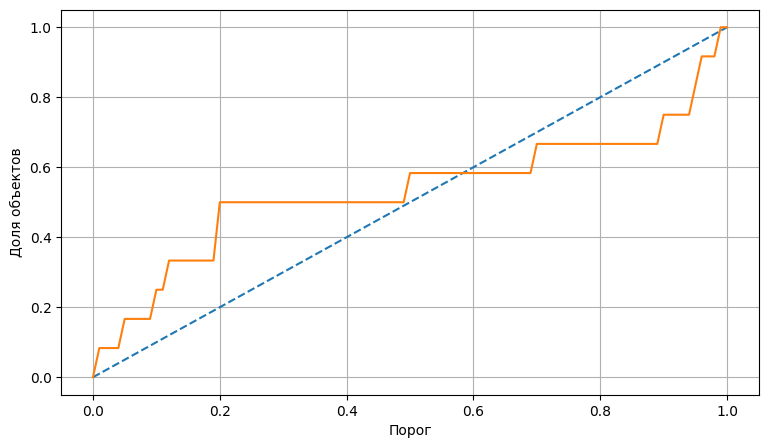

In [ ]:
x, y = plot_calibration_curve(preds)

In [ ]:
preds_new = np.zeros_like(preds)

for i in range(len(preds)):
    thr = preds[i]
    x = len(np.where(preds <= thr)[0]) / len(preds)
    preds_new[i] = x

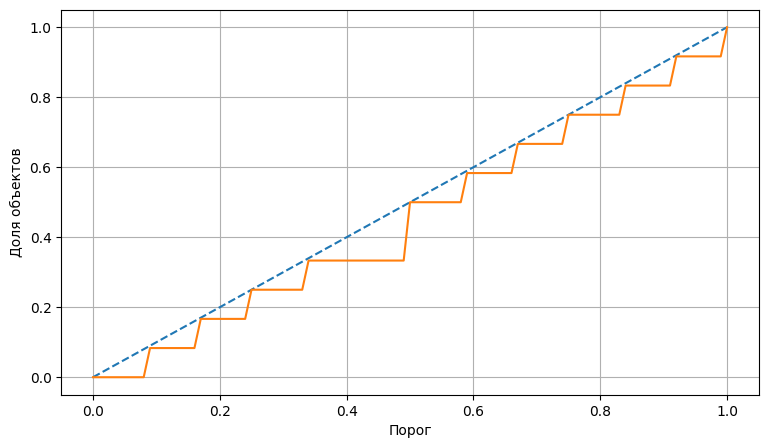

In [ ]:
x, y = plot_calibration_curve(preds_new)

In [ ]:
preds = np.sort(preds)
preds_new = np.sort(preds_new)

In [ ]:
preds, preds_new

(array([0.01, 0.05, 0.1 , 0.12, 0.2 , 0.2 , 0.5 , 0.7 , 0.9 , 0.95, 0.96,
        0.99]),
 array([0.08333333, 0.16666667, 0.25      , 0.33333333, 0.5       ,
        0.5       , 0.58333333, 0.66666667, 0.75      , 0.83333333,
        0.91666667, 1.        ]))

In [ ]:
preds_test = np.array([0.1, 0.2, 0.3, 0.4, 0.5, 0.7, 0.9])

def calibration(preds_test, preds, preds_true):

    preds_test_new = np.zeros_like(preds_test)

    for i in range(len(preds_test)):

        x = preds_test[i]
        idx = 0
        while preds[idx] < x:
            idx += 1

        preds_test_new[i] = preds_true[idx]

    return preds_test_new

In [ ]:
calibration(preds_test, preds, preds_new)

array([0.25      , 0.5       , 0.58333333, 0.58333333, 0.58333333,
       0.66666667, 0.75      ])

# train val test

In [11]:
!mkdir "bin/0resLT"
!mkdir "bin/0resRB"
!mkdir "bin/1resLT"
!mkdir "bin/1resRB"

mkdir: cannot create directory ‘bin/0resLT’: File exists
mkdir: cannot create directory ‘bin/1resRB’: File exists


In [17]:
def dir_paths(dir):
    paths = []
    for p in sorted(os.listdir(dir)):
        path = os.path.join(dir, p)
        paths.append(path)
    return paths


def file_name(path):
    p = re.split(r"/", path)
    return p[-1]


def plot_transformed_images(image_paths, transform, save_dir, n=3):
    # https://www.learnpytorch.io/04_pytorch_custom_datasets/
    # random_image_paths = random.sample(image_paths, k=n)

    if n:
        image_paths = image_paths[:n]

    for image_path in image_paths:
        name = file_name(image_path)
        f = Image.open(image_path)
        plt.figure(figsize=(20, 6))
        w, h = f.size

        t = ""
        if w > h:
            transnew = (transform[2], transform[3])
            t = "left rigth"
        else:
            transnew = (transform[0], transform[1])
            t = "top bottom"

        num_trans = len(transnew)

        plt.subplot(1,  num_trans+1, 1)
        plt.imshow(f)
        plt.title(f"{name}\nSize h x w: {h} x {w}")
        plt.axis("off")

        for i in range(num_trans):
            transformed_image = transnew[i](f)

            if i == 0:
                save_image(transformed_image, f"{save_dir}LT/{name}")
            elif i == 1:
                save_image(transformed_image, f"{save_dir}RB/{name}")

            plt.subplot(1, num_trans+1, i+2)
            plt.imshow(transformed_image.permute(1, 2, 0))
            plt.title(f"{t}\nSize: {tuple(transformed_image.shape)}")
            plt.axis("off")

        plt.show()

In [6]:
f = Image.open("bin/1res/2-Вяземскому (плохой)!.png")
x = transforms.ToTensor()(f).permute(1, 2, 0)

In [7]:
# torch.unique(x, return_counts=True)

In [18]:
def TopHalf():
    def fun(tensor):
        c, h, w = tensor.shape
        res = v2.functional.crop(tensor, top = 0, left = 0, height = h // 2, width = w)
        return res
    return fun

def BottomHalf():
    def fun(tensor):
        c, h, w = tensor.shape
        res = v2.functional.crop(tensor, top = h // 2, left = 0, height = h // 2, width = w)
        return res
    return fun

def LeftHalf():
    def fun(tensor):
        c, h, w = tensor.shape
        res = v2.functional.crop(tensor, top = 0, left = 0, height = h, width = w // 2)
        return res
    return fun

def RigthHalf():
    def fun(tensor):
        c, h, w = tensor.shape
        res = v2.functional.crop(tensor, top = 0, left = w // 2, height = h, width = w // 2)
        return res
    return fun

In [19]:
trans_left = transforms.Compose(
    [
            # transforms.RandomCrop(300),
            # transforms.CenterCrop(224),
            # transforms.RandomPerspective(distortion_scale=0.5, p=0.5, fill=255),
            transforms.ToTensor(),
            # v2.Pad(padding=150, fill=1),
            LeftHalf(),
    ])

trans_right = transforms.Compose(
    [
            transforms.ToTensor(),
            RigthHalf(),
    ])

trans_top = transforms.Compose(
    [
            transforms.ToTensor(),
            TopHalf(),
    ])

trans_bottom = transforms.Compose(
    [
            transforms.ToTensor(),
            BottomHalf(),
    ])

In [20]:
plot_transformed_images(dir_paths("bin/1res"),
        (trans_top, trans_bottom, trans_left, trans_right), save_dir = "bin/1res", n=0)

Output hidden; open in https://colab.research.google.com to view.

In [21]:
plot_transformed_images(dir_paths("bin/0res"),
        (trans_top, trans_bottom, trans_right, trans_left), save_dir = "bin/0res", n=0)

Output hidden; open in https://colab.research.google.com to view.

# siam

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
cd drive/MyDrive/Colab\ Notebooks/mest

/content/drive/MyDrive/Colab Notebooks/mest


In [3]:
!pip install -q hydra-core==1.3

In [4]:
import json, os
import matplotlib.pyplot as plt

from torchvision import datasets, models, transforms
from time import time
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from torchvision import models, transforms
from torchvision.transforms import v2
from PIL import Image, ImageOps
from tqdm import tqdm
from functools import partial
from torchvision.utils import save_image

from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import torch
import os, json, cv2, re
import numpy as np
import random
import pickle

from src.dataset import My_Dataset, TripletDataset, Emb_Dataset, Pipeline
from src.functions import number_of_parameters, seed_everything
from src.dataset_fun import split_dataset
from src import siamese, classifier
from src.classifier import get_predictions
from src.train import train, load_logs, load_model, save_logs, load_logs
from src.functions import confusion_matrix, distribution, create_model
from src.show_fun import show_result, show_images, plot_transformed_images

from src.commands import hydra_config, show_CONF, config_model
from src.commands import common_train, load_best_model, pos_neg_dataset

In [ ]:
def graph_logs(logs, num=None, ylog=True):
    plt.figure(figsize=(15, 6))

    if not num:
        num = len(logs["epoch"])

    x = logs["epoch"][:num]
    y1 = logs["train_loss"][:num]
    y2 = logs["val_loss"][:num]

    plt.subplot(1, 2, 1)
    graph2(x, y1, y2, title="", ylog=ylog, ylabel="loss")

    x = logs["epoch"][:num]
    y1 = logs["train_accuracy"][:num]
    y2 = logs["val_accuracy"][:num]

    plt.subplot(1, 2, 2)
    graph2(x, y1, y2, title="", ylog=ylog, ylabel="accuracy")

    plt.show()

In [ ]:
CONF1 = hydra_config("config (siam).yaml")
show_CONF(CONF1)

{
        "seed": 42,
        "device": "cuda",
        "save_path": "checkpoints",
        "dataset": {
                "data_pos": "bin/1res",
                "data_neg": "bin/0res",
                "threshold": 0.95
        },
        "loader": {
                "batch_size": 64
        },
        "siamese": {
                "n_epochs": 50,
                "learning_rate": 0.0003,
                "margin": 9,
                "path_model": "checkpoints/siamese",
                "path_log": "checkpoints/siamese/siamese.pickle"
        },
        "classifier": {
                "n_epochs": 30,
                "learning_rate": 0.0003,
                "path_model": "checkpoints/classifier",
                "path_log": "checkpoints/classifier/classifier.pickle"
        }
}


In [ ]:
CONF1.dataset.threshold = 0.9

In [ ]:
transform = transforms.Compose(
    [
            transforms.RandomCrop(300),
            # transforms.CenterCrop(224),
            # transforms.RandomPerspective(distortion_scale=0.5, p=0.5, fill=255),
            transforms.ToTensor(),
    ])

pos_dataset, neg_dataset = pos_neg_dataset(CONF1, transform, pos_aug=40, neg_aug=5)

Positive dataset: 1000    (25)
Доля белого больше у 358 картинки!!!
bin/0res/37-21.png
Доля белого больше у 580 картинки!!!
bin/0res/37-21.png
Negative dataset: 1110    (222)


In [ ]:
siam = models.resnet18(weights=models.ResNet18_Weights.DEFAULT).to(CONF1.device)
num_classes = 1000
num_non_freeze = 513000
seed_everything(CONF1.seed)
siam = create_model(siam, num_non_freeze, num_classes, verbose=False).to(CONF1.device)
print(f"num parameters ResNet = {number_of_parameters(siam)}")

num parameters ResNet = 513000


In [ ]:
dataset_tri = TripletDataset(
        pos_dataset, neg_dataset, required_len=10_000, deterministic=True, seed=CONF1.seed
    )
seed_everything(CONF1.seed)
train_dataset, test_dataset = split_dataset(dataset_tri)
common_train(CONF1, siam, train_dataset, test_dataset, kind="siam")
load_best_model(CONF1, siam, train_dataset, test_dataset, kind="siam")
logs = load_logs(CONF1.siamese.path_log)
graph_logs(logs, num=0)

split_dataset: Train: 8000 Test: 2000 Total: 10000
train: started, kind = 'siam'
# 2024-06-18 15:27:29 Epoch  1 train/val: loss 2.51319/2.78795, acc: 94.663%/ 92.650%
# 2024-06-18 15:29:27 Epoch  2 train/val: loss 1.81387/2.08110, acc: 96.037%/ 94.600%
# 2024-06-18 15:31:24 Epoch  3 train/val: loss 1.33642/1.58711, acc: 97.488%/ 96.100%
# 2024-06-18 15:33:17 Epoch  4 train/val: loss 1.25838/1.52140, acc: 97.675%/ 96.500%
# 2024-06-18 15:35:14 Epoch  5 train/val: loss 1.14984/1.44390, acc: 97.988%/ 96.500%
# 2024-06-18 15:37:08 Epoch  6 train/val: loss 1.07593/1.37230, acc: 98.250%/ 96.750%
# 2024-06-18 15:39:02 Epoch  7 train/val: loss 0.97813/1.28650, acc: 98.300%/ 97.450%
# 2024-06-18 15:40:57 Epoch  8 train/val: loss 0.93458/1.23276, acc: 98.537%/ 97.200%
# 2024-06-18 15:42:48 Epoch  9 train/val: loss 0.91712/1.23065, acc: 98.537%/ 97.350%
# 2024-06-18 15:44:43 Epoch 10 train/val: loss 0.89074/1.20589, acc: 98.587%/ 97.150%
# 2024-06-18 15:46:39 Epoch 11 train/val: loss 0.88677/1.21

KeyboardInterrupt: 

In [ ]:
cl = nn.Sequential(nn.Linear(num_classes, 512), nn.ReLU(), nn.Linear(512, 2)).to(
    CONF1.device
)
num_param = number_of_parameters(cl)
print(f"num parameters = {num_param}")

dataset = torch.utils.data.ConcatDataset([pos_dataset, neg_dataset])
dataset_emb = Emb_Dataset(siam, dataset, CONF1.device)
seed_everything(CONF1.seed)
train_dataset, test_dataset = split_dataset(dataset_emb)

common_train(CONF1, cl, train_dataset, test_dataset, kind="cl")
load_best_model(CONF1, cl, train_dataset, test_dataset, kind="cl")
logs = load_logs(CONF1.classifier.path_log)
graph_logs(logs, num=0)

model = Pipeline(siam, cl, CONF1)

num parameters = 513538
split_dataset: Train: 1688 Test: 422 Total: 2110
train: started, kind = 'cl'
# 2024-06-18 16:32:56 Epoch  1 train/val: loss 0.08749/0.07556, acc: 97.216%/ 97.867%
# 2024-06-18 16:33:12 Epoch  2 train/val: loss 0.05681/0.05911, acc: 98.282%/ 97.867%
# 2024-06-18 16:33:26 Epoch  3 train/val: loss 0.04116/0.04383, acc: 98.934%/ 98.341%
# 2024-06-18 16:33:41 Epoch  4 train/val: loss 0.02739/0.02636, acc: 99.348%/ 99.526%
# 2024-06-18 16:33:56 Epoch  5 train/val: loss 0.02118/0.02568, acc: 99.467%/ 99.052%
# 2024-06-18 16:34:11 Epoch  6 train/val: loss 0.01599/0.02318, acc: 99.882%/ 99.289%
# 2024-06-18 16:34:25 Epoch  7 train/val: loss 0.01244/0.01448, acc: 99.763%/ 99.763%
# 2024-06-18 16:34:40 Epoch  8 train/val: loss 0.01107/0.02270, acc: 99.882%/ 98.815%
# 2024-06-18 16:34:55 Epoch  9 train/val: loss 0.00768/0.01126, acc: 99.941%/100.000%
# 2024-06-18 16:35:09 Epoch 10 train/val: loss 0.00658/0.01810, acc: 99.941%/ 99.289%
# 2024-06-18 16:35:24 Epoch 11 train/va

KeyboardInterrupt: 

In [ ]:
model = Pipeline(siam, cl, CONF1)

Total:  0.999526066350711


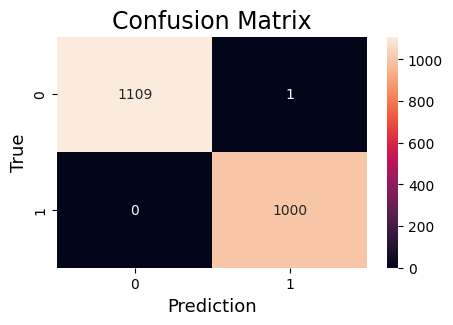

[[1109    1]
 [   0 1000]]
Positive:  1.0
Negative:  1.0


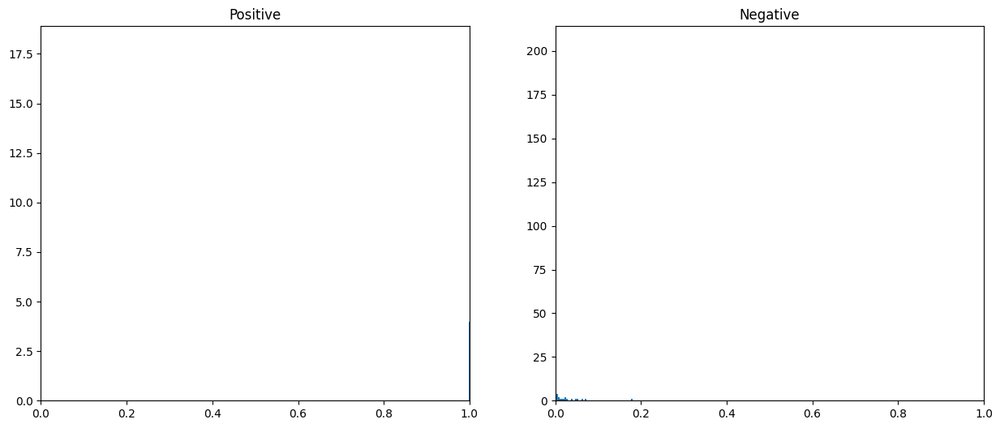

In [ ]:
X, y_true1, y_pred1, y_prob = get_predictions(model, dataset,
                                            CONF1.loader.batch_size, CONF1.device)
print("Total: ", accuracy_score(y_pred1, y_true1))
print(confusion_matrix(y_true1, y_pred1))

X, y_true2, y_pred2, y_prob2 = get_predictions(model, pos_dataset,
                                            CONF1.loader.batch_size, CONF1.device)
print("Positive: ", accuracy_score(y_pred2, y_true2))

plt.figure(figsize=(15, 6))
plt.subplot(1, 2, 1)
plt.title("Positive")
distribution(y_prob2)

X, y_true3, y_pred3, y_prob3 = get_predictions(model, neg_dataset,
                                            CONF1.loader.batch_size, CONF1.device)
print("Negative: ", accuracy_score(y_pred3, y_true3))
plt.subplot(1, 2, 2)
plt.title("Negative")
distribution(y_prob3)
plt.show()

In [ ]:
pos_dataset, neg_dataset = pos_neg_dataset(CONF1, transform, pos_aug=1, neg_aug=1)

Positive dataset: 25    (25)
Negative dataset: 222    (222)


prob > 0
count : 222 out of 222
pic idx : [196, 110, 35, 63, 59, 200, 207, 41, 61, 137, 62, 17, 132, 129, 30, 148, 133, 34, 26, 93, 192, 209, 2, 38, 31, 22, 178, 190, 145, 74, 147, 199, 23, 52, 49, 165, 141, 56, 21, 188, 210, 153, 42, 98, 103, 9, 130, 131, 64, 112, 114, 19, 10, 105, 128, 127, 27, 104, 191, 67, 135, 214, 159, 47, 94, 8, 39, 136, 32, 146, 106, 176, 139, 181, 65, 50, 43, 71, 86, 140, 75, 126, 3, 174, 186, 55, 221, 88, 28, 25, 15, 24, 6, 213, 152, 122, 76, 100, 184, 151, 57, 101, 81, 155, 206, 205, 73, 204, 108, 149, 58, 0, 150, 194, 160, 109, 77, 111, 45, 113, 219, 1, 16, 198, 144, 14, 97, 89, 177, 124, 87, 216, 173, 182, 91, 46, 99, 96, 36, 187, 138, 162, 168, 134, 53, 117, 78, 125, 197, 29, 11, 116, 120, 90, 92, 4, 193, 18, 37, 95, 121, 185, 7, 143, 70, 79, 208, 115, 85, 157, 44, 167, 154, 163, 179, 201, 211, 84, 12, 40, 215, 189, 217, 203, 107, 82, 119, 118, 80, 220, 83, 156, 102, 51, 54, 20, 13, 66, 175, 195, 60, 161, 212, 158, 142, 170, 166, 183, 172, 218, 5, 68, 171

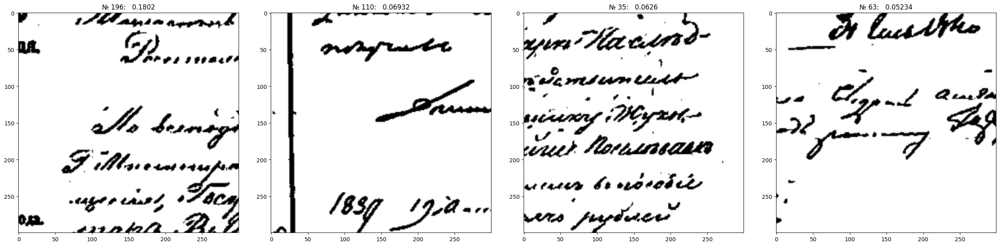

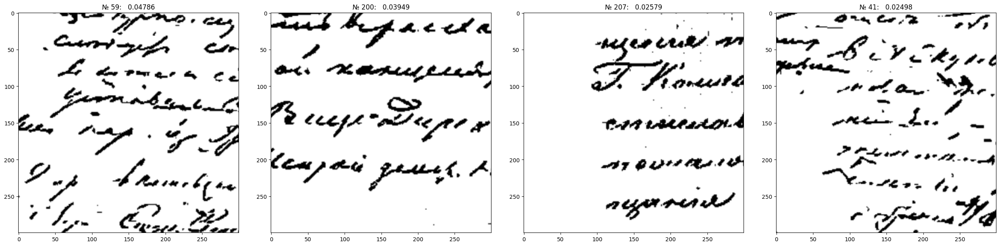

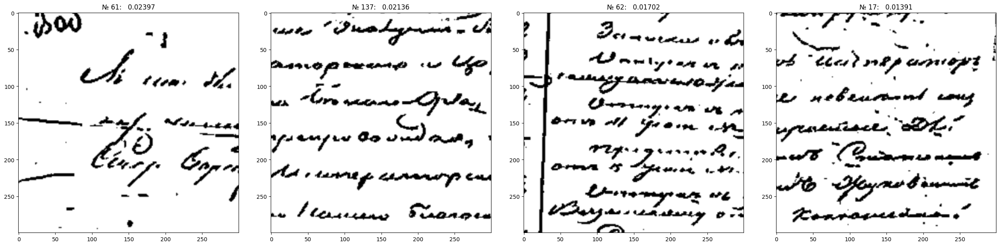

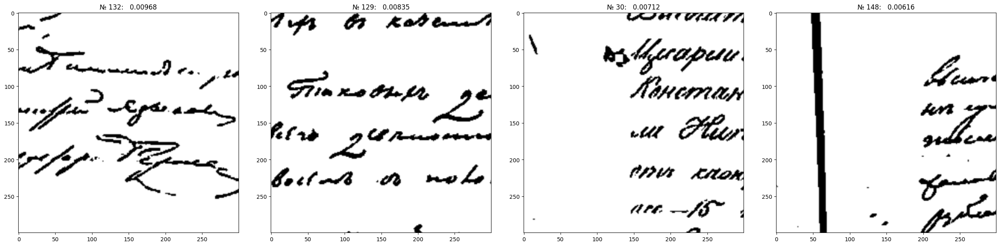

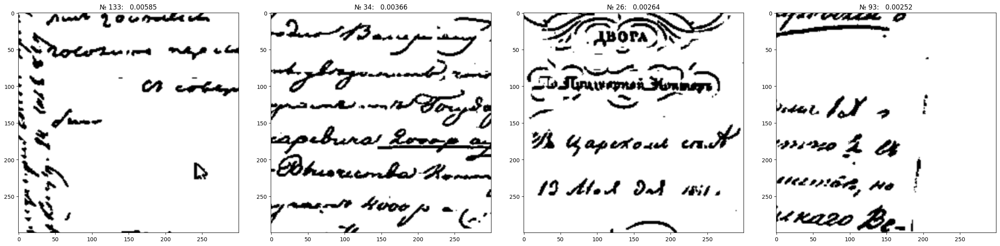

...

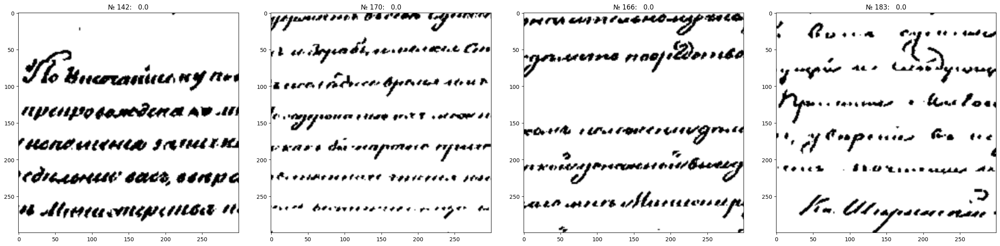

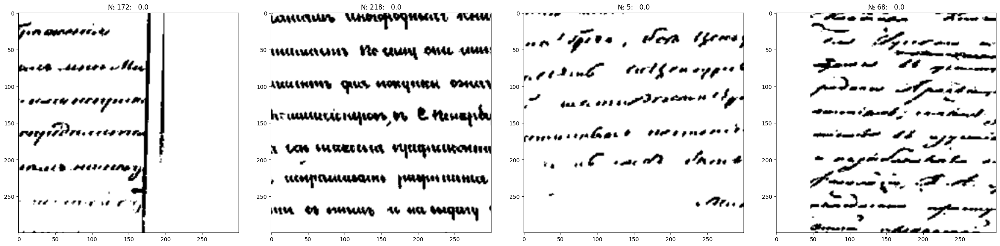

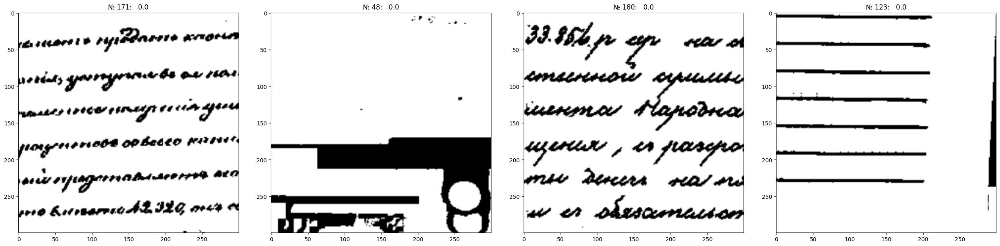

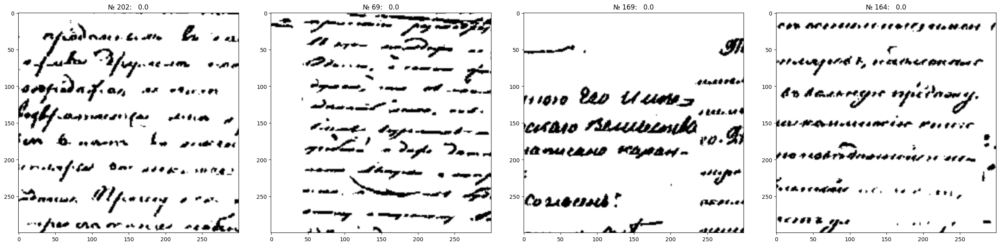

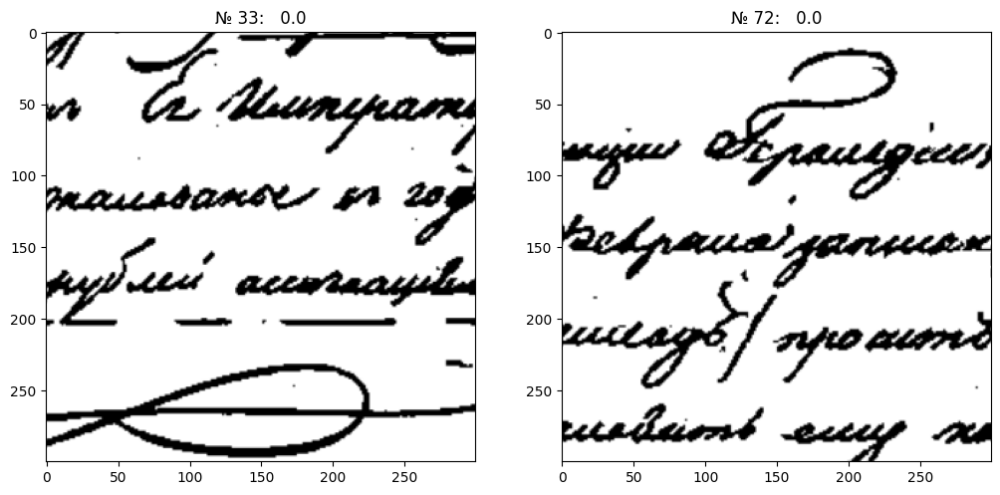

In [ ]:
X, y_true, y_pred, y_prob, indices = show_result(model, neg_dataset, 0,
                                   CONF1.loader.batch_size, CONF1.device,
                                   greater = True, col = None,
                                   sort = True)

prob > 0
count : 25 out of 25
pic idx : [14, 9, 12, 21, 3, 8, 5, 0, 24, 22, 15, 13, 23, 19, 6, 17, 10, 18, 11, 20, 2, 16, 1, 7, 4]


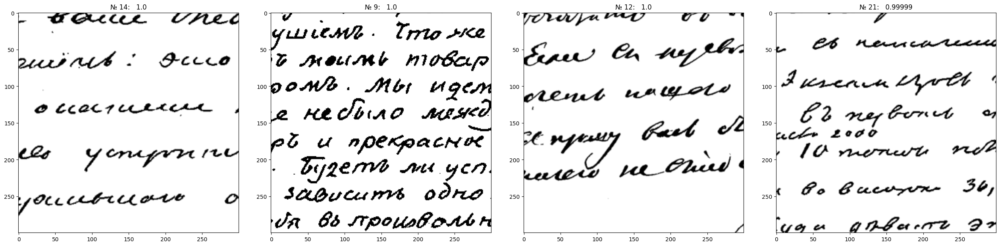

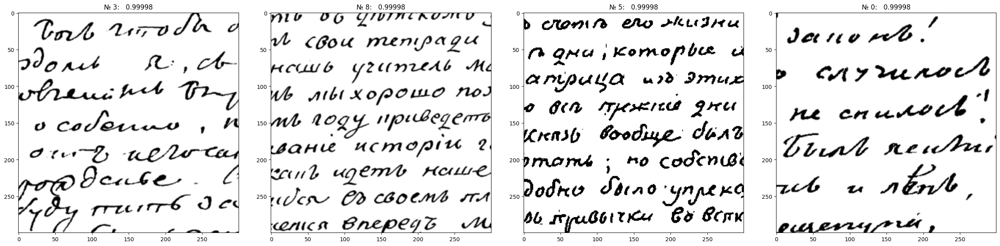

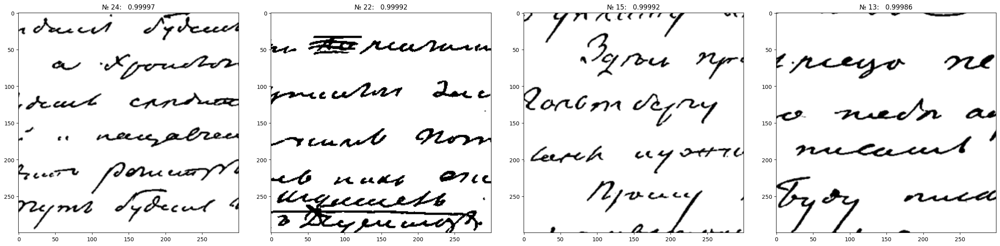

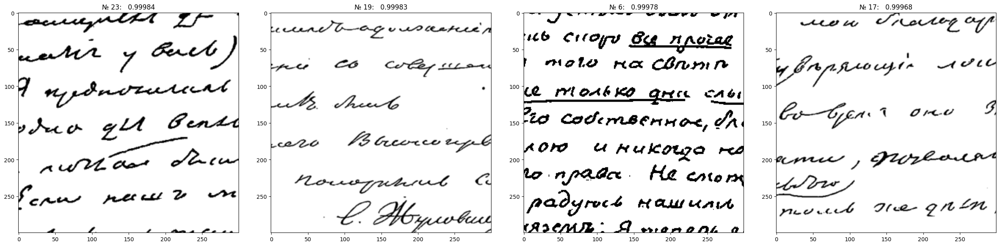

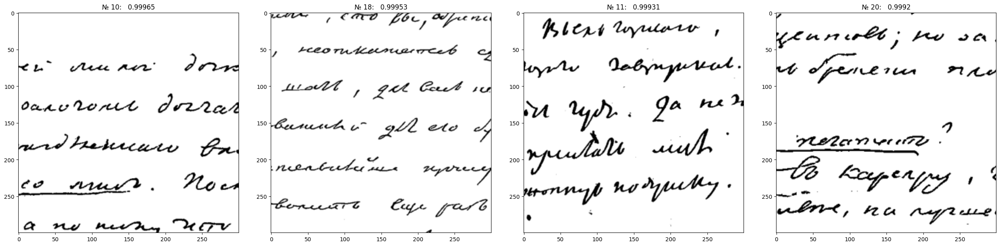

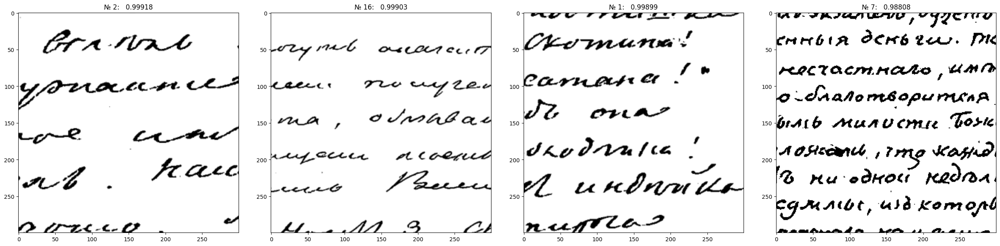

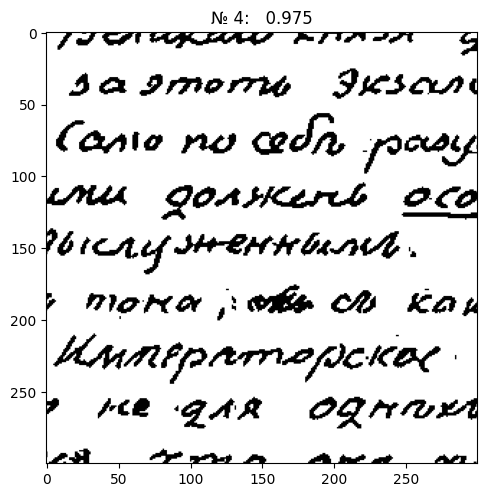

In [ ]:
X, y_true, y_pred, y_prob, indices = show_result(model, pos_dataset, 0,
                                   CONF1.loader.batch_size, CONF1.device,
                                   greater = True, col = None,
                                   sort = True)